# Building MapVisualiser:

Building MapVisaliser from zero based on example of Pakistan flood from 2022
1. Downloading Dask datacube (data of Pakistan with all variables) and preparing MapVisualiser
2. Refinement and variable selection
3. Building basic polygons - Polygol I
4. Creation of new variables - Product variables
5. New Variables - Binned Likelihood x Flood Extent - Polygonised
6. Creation png/img files as output 


In [ ]:
import pystac_client
from dask.distributed import Client
import sys
from pathlib import Path
sys.path.append(str(Path.cwd() / "dynamic-flood-visualization" / "src"))

project_root = Path.cwd().parent.parent  # goes from visualizations/jonas -> visualizations -> project root
src_path = project_root / "src"
assert src_path.exists(), f"src path not found: {src_path}"
if str(src_path) not in sys.path:
    sys.path.insert(0, str(src_path))

from dcloader import DcLoader
#from dynamic-flood-visualization.src.dcloader import DcLoader
import matplotlib.pyplot as plt
import xarray as xr
from mapvisualiser import MapVisualiser
import rioxarray
import hvplot.xarray
from color_schemes import COLOR_PALETTES

cache_file = '../../data/germany_flood_cache.nc'
eodc_catalog = pystac_client.Client.open("https://stac.eodc.eu/api/v1/")
time_range_germany = '2022-09-23T01:25:51Z/2022-09-23T01:25:52Z'
time_range = "2023-10-11/2023-10-25"
time_range_germany = time_range
minlon, maxlon = 12.3, 13.1
minlat, maxlat = 54.3, 54.6
bounding_box = [minlon, minlat, maxlon, maxlat]
bounding_box_germany = bounding_box

client = Client(processes=False, threads_per_worker=2, n_workers=3, memory_limit="12GB")
print(f"Dask dashboard link: {client.dashboard_link}")
dc_loader = DcLoader(eodc_catalog)
dc_loader.load_GFM_data(time_range_germany, bounding_box_germany)
# dc must be saved and loaded again as we want to store it directly at the MaVisualiser
# as we don't want to 
flood_variables = ['dlr_likelihood', 'tuw_likelihood', 'list_likelihood', 'dlr_flood_extent', 'tuw_flood_extent', 'list_flood_extent', 'ensemble_likelihood', 'ensemble_flood_extent', 'ensemble_water_extent']
mask_variables = ['reference_water_mask', 'exclusion_mask', 'advisory_flags']
#dc_loader.compute_swath_mosaic(flood_variables=flood_variables, mask_variables=mask_variables, debug=True, persist=True)
dc_loader.save_to_netcdf(cache_file)
client.close()
dc_loader =  DcLoader(eodc_catalog, netcdf_path=cache_file)
dc_loader.compute_swath_mosaic(flood_variables=flood_variables, mask_variables=mask_variables, debug=False, persist=True)

## Creating MapVisualiser instance 
visualiser = MapVisualiser(dcloader_instance=dc_loader)
visualiser.flood_variables = [var for var in visualiser.flood_variables if var != 'spatial_ref' ]
print(visualiser.flood_variables)
print(visualiser)

SyntaxError: invalid syntax (3040123335.py, line 22)

Selecting and refining variable 'dlr_likelihood'...
Variable refined successfully.
Selecting and refining variable 'tuw_likelihood'...
Variable refined successfully.
Selecting and refining variable 'list_likelihood'...
Variable refined successfully.
Selecting and refining variable 'dlr_flood_extent'...
Variable refined successfully.
Selecting and refining variable 'tuw_flood_extent'...
Variable refined successfully.
Selecting and refining variable 'list_flood_extent'...
Variable refined successfully.
Selecting and refining variable 'ensemble_likelihood'...
Variable refined successfully.
Selecting and refining variable 'ensemble_flood_extent'...
Variable refined successfully.
Selecting and refining variable 'ensemble_water_extent'...
Variable refined successfully.
Plotting 4 refined variables in a 2x2 grid...
Grid plot created successfully.


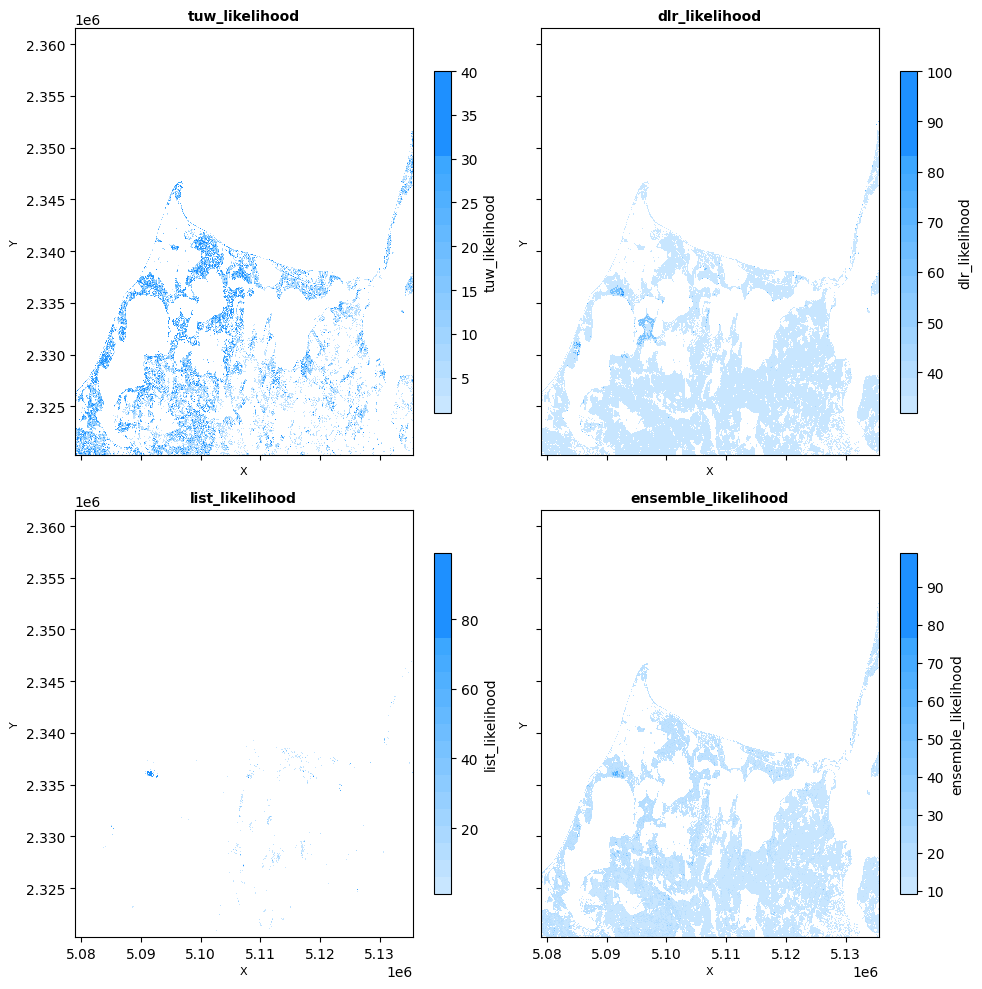

In [2]:
visualiser.select_and_refine_all_vars()
visualiser.plot_refined_data_grid(["tuw_likelihood","dlr_likelihood","list_likelihood","ensemble_likelihood"]) 

In [3]:
visualiser.prepare_for_map_overlay_all_vars()
visualiser.plot_on_map(variable_name='tuw_flood_extent',alpha=1 ,cmap=COLOR_PALETTES['light_to_strong_blue'])

Reprojecting data for map overlay...
Reprojecting data for map overlay...
Reprojecting data for map overlay...
Reprojecting data for map overlay...
Reprojecting data for map overlay...
Reprojecting data for map overlay...
Reprojecting data for map overlay...
Reprojecting data for map overlay...
Reprojecting data for map overlay...
Generating interactive map...


:Overlay
   .WMTS.I  :WMTS   [Longitude,Latitude]
   .Image.I :Image   [x,y]   (tuw_flood_extent)

Plotting 4 refined variables in a 2x2 grid...
Grid plot created successfully.


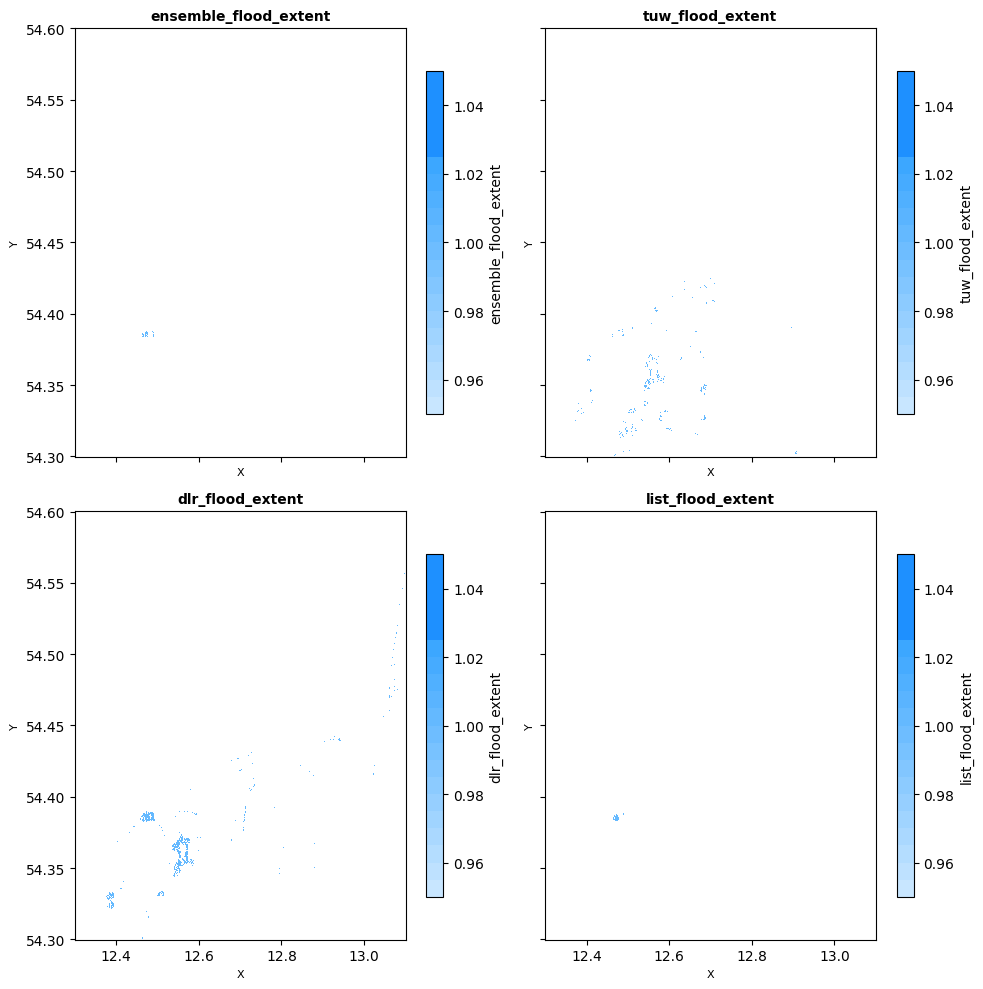

In [4]:
# visualiser.plot_plottable_data_grid()
visualiser.plot_plottable_data_grid(variables=['ensemble_flood_extent','tuw_flood_extent','dlr_flood_extent','list_flood_extent'],cmap=COLOR_PALETTES['light_to_strong_blue'])

In [5]:
visualiser.plot_plottable_data("ensemble_likelihood",cmap=COLOR_PALETTES['light_to_strong_blue'])

Creating interactive map for 'ensemble_likelihood'...
Interactive map created successfully.


:Overlay
   .WMTS.I  :WMTS   [Longitude,Latitude]
   .Image.I :Image   [x,y]   (ensemble_likelihood)

In [6]:
# matvis save
visualiser_file = "../../data/germany_visualiser.mapvis"
visualiser.save_to_file(visualiser_file)
del visualiser

Saving MapVisualiser to ../../data/germany_visualiser...


Saving MapVisualiser:   0%|          | 0/22 [00:00<?, ?step/s]

✓ MapVisualiser saved successfully to ../../data/germany_visualiser
  Main file: ../../data/germany_visualiser.mapvis
  Total files created: 5


In [7]:
visualiser2 = MapVisualiser(load_from_file=visualiser_file)
visualiser2.build_polygons('tuw_flood_extent', smooth_distance=0.01, save_to_polygons=True)
visualiser2.build_polygons('ensemble_flood_extent',save_to_polygons=True)

Loading MapVisualiser from ../../data/germany_visualiser.mapvis...


Loading MapVisualiser:   0%|          | 0/4 [00:00<?, ?step/s]

✓ MapVisualiser loaded successfully
  CRS: PROJCS["Azimuthal_Equidistant",GEOGCS["WGS 84",DATUM["WGS_1984",SPHEROID["WGS 84",6378137,298.257223563,AUTHORITY["EPSG","7030"]],AUTHORITY["EPSG","6326"]],PRIMEM["Greenwich",0],UNIT["degree",0.0174532925199433],AUTHORITY["EPSG","4326"]],PROJECTION["Azimuthal_Equidistant"],PARAMETER["latitude_of_center",53],PARAMETER["longitude_of_center",24],PARAMETER["false_easting",5837287.81977],PARAMETER["false_northing",2121415.69617],UNIT["metre",1,AUTHORITY["EPSG","9001"]]]
  Bounding box: [12.3 54.3 13.1 54.6]
  Flood variables: 9
  Refined variables: 9
  Plottable variables: 9
  Polygon variables: 0
  Saved on: 2025-12-02T13:33:51.459594
Building polygons for 'tuw_flood_extent'...
  Filling holes in polygons...
  Smoothing polygons...
    Using projected CRS, buffer distance: 0.01 units
Polygons built successfully for 'tuw_flood_extent'. Found 746 polygon(s).
Building polygons for 'ensemble_flood_extent'...
  Filling holes in polygons...
  Smoothing 

,geometry
0,"POLYGON ((12.919 54.44, 12.919 54.44, 12.919 5..."
1,"POLYGON ((12.489 54.388, 12.489 54.388, 12.489..."
2,"POLYGON ((12.463 54.387, 12.463 54.387, 12.463..."
3,"POLYGON ((12.463 54.386, 12.463 54.386, 12.463..."
4,"POLYGON ((12.464 54.385, 12.464 54.385, 12.464..."
5,"POLYGON ((12.463 54.386, 12.463 54.386, 12.463..."
6,"POLYGON ((12.491 54.385, 12.491 54.385, 12.491..."
7,"POLYGON ((12.464 54.384, 12.464 54.384, 12.464..."
8,"POLYGON ((12.487 54.387, 12.487 54.387, 12.487..."
9,"POLYGON ((12.465 54.384, 12.465 54.384, 12.465..."


In [8]:
visualiser2.plot_polygon_on_map(variable_name='tuw_flood_extent', alpha=0.7, color=COLOR_PALETTES['light_to_strong_blue'])

:Overlay
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]

In [9]:
visualiser2.plot_polygon_on_map(variable_name='ensemble_flood_extent', alpha=0.7, color=COLOR_PALETTES['light_to_strong_blue'])


:Overlay
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]

### Creating new variables - Product plottables 
using apply method you can apply simple mathematical functions on muliple plottable variables


Parsing expression: 'tuw_flood_extent * ensemble_likelihood'
  Validating shapes (reference: (1048, 2793))...
  ✓ All variables have compatible shapes
  Evaluating expression...
  Saved to plottable_data['Flood1']
✓ Expression evaluated successfully
  Result shape: (1048, 2793)
  Result name: 'Flood1'
Parsing expression: 'ensemble_flood_extent * ensemble_likelihood'
  Validating shapes (reference: (1048, 2793))...
  ✓ All variables have compatible shapes
  Evaluating expression...
  Saved to plottable_data['Flood2']
✓ Expression evaluated successfully
  Result shape: (1048, 2793)
  Result name: 'Flood2'
Parsing expression: ' dlr_flood_extent * ensemble_likelihood'
  Validating shapes (reference: (1048, 2793))...
  ✓ All variables have compatible shapes
  Evaluating expression...
  Saved to plottable_data['Flood3']
✓ Expression evaluated successfully
  Result shape: (1048, 2793)
  Result name: 'Flood3'
Saving MapVisualiser to ../../data/germany2/germany_visualiser_with_floods...


Saving MapVisualiser:   0%|          | 0/27 [00:00<?, ?step/s]

✓ MapVisualiser saved successfully to ../../data/germany2/germany_visualiser_with_floods
  Main file: ../../data/germany2/germany_visualiser_with_floods.mapvis
  Total files created: 7
Plotting 3 refined variables in a 1x3 grid...
Grid plot created successfully.


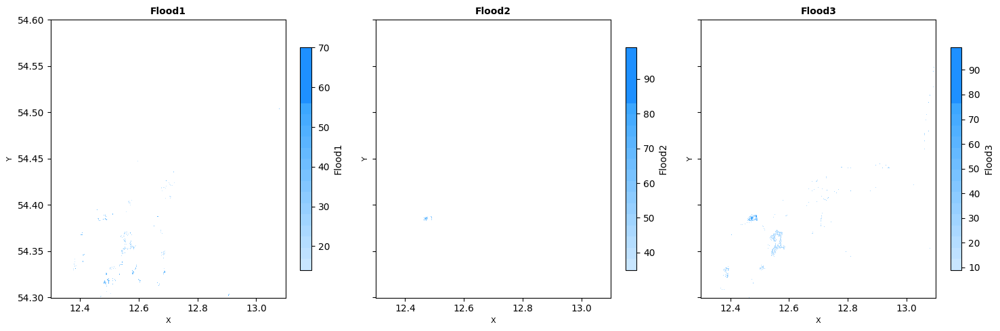

In [10]:
visualiser2.apply_plottable("tuw_flood_extent * ensemble_likelihood", "Flood1", save_to_plottable=True)
visualiser2.apply_plottable("ensemble_flood_extent * ensemble_likelihood", "Flood2", save_to_plottable=True)
visualiser2.apply_plottable(" dlr_flood_extent * ensemble_likelihood", "Flood3", save_to_plottable=True)

new_visualiser_file = "../../data/germany2/germany_visualiser_with_floods.mapvis"
visualiser2.save_to_file(new_visualiser_file)

visualiser2.plot_plottable_data_grid(variables=['Flood1','Flood2','Flood3'], cmap=COLOR_PALETTES['light_to_strong_blue'])

In [11]:
visualiser2.plot_on_map(variable_name='Flood2', alpha=0.7, cmap=COLOR_PALETTES['light_to_strong_blue'])

Generating interactive map...


:Overlay
   .WMTS.I  :WMTS   [Longitude,Latitude]
   .Image.I :Image   [x,y]   (Flood2)

In [12]:
visualiser2.plot_on_map(variable_name='Flood3', alpha=0.7, cmap=COLOR_PALETTES['blue_to_red_extended'].reverse())
new_visualiser_file2 = "../../data/germany3/germany_visualiser_with_floods_map2.mapvis"
visualiser2.save_to_file(new_visualiser_file2)

Generating interactive map...
Saving MapVisualiser to ../../data/germany3/germany_visualiser_with_floods_map2...


Saving MapVisualiser:   0%|          | 0/27 [00:00<?, ?step/s]

✓ MapVisualiser saved successfully to ../../data/germany3/germany_visualiser_with_floods_map2
  Main file: ../../data/germany3/germany_visualiser_with_floods_map2.mapvis
  Total files created: 7


In [13]:
# del visualiser2

### Apply binning for Flood variables
I define binnig in following way:
